This is just messing around with the output files of the original code, we are working with them as txt files when originally they were ts type. The third entry of the output file represents if the neuron is a pyramidal neuron or an inhibitory neuron. 1 means pyramidal, 0 means inhibitory, that explains the overlap. 

In [25]:
import numpy as np
import matplotlib.pyplot as plt
import numpy.fft as fft

vals = [0,0.33,0.66,0.99]

#this array will contain all the combinations we will run through
cs = np.zeros((64,4))
#loop through all possible combinations
counter = 0
for i in range(4):
    for j in range(4):
        for k in range(4):
            cs[counter] = np.array((vals[i],vals[j],vals[k],counter))
            counter += 1

print(cs)

[[ 0.    0.    0.    0.  ]
 [ 0.    0.    0.33  1.  ]
 [ 0.    0.    0.66  2.  ]
 [ 0.    0.    0.99  3.  ]
 [ 0.    0.33  0.    4.  ]
 [ 0.    0.33  0.33  5.  ]
 [ 0.    0.33  0.66  6.  ]
 [ 0.    0.33  0.99  7.  ]
 [ 0.    0.66  0.    8.  ]
 [ 0.    0.66  0.33  9.  ]
 [ 0.    0.66  0.66 10.  ]
 [ 0.    0.66  0.99 11.  ]
 [ 0.    0.99  0.   12.  ]
 [ 0.    0.99  0.33 13.  ]
 [ 0.    0.99  0.66 14.  ]
 [ 0.    0.99  0.99 15.  ]
 [ 0.33  0.    0.   16.  ]
 [ 0.33  0.    0.33 17.  ]
 [ 0.33  0.    0.66 18.  ]
 [ 0.33  0.    0.99 19.  ]
 [ 0.33  0.33  0.   20.  ]
 [ 0.33  0.33  0.33 21.  ]
 [ 0.33  0.33  0.66 22.  ]
 [ 0.33  0.33  0.99 23.  ]
 [ 0.33  0.66  0.   24.  ]
 [ 0.33  0.66  0.33 25.  ]
 [ 0.33  0.66  0.66 26.  ]
 [ 0.33  0.66  0.99 27.  ]
 [ 0.33  0.99  0.   28.  ]
 [ 0.33  0.99  0.33 29.  ]
 [ 0.33  0.99  0.66 30.  ]
 [ 0.33  0.99  0.99 31.  ]
 [ 0.66  0.    0.   32.  ]
 [ 0.66  0.    0.33 33.  ]
 [ 0.66  0.    0.66 34.  ]
 [ 0.66  0.    0.99 35.  ]
 [ 0.66  0.33  0.   36.  ]
 

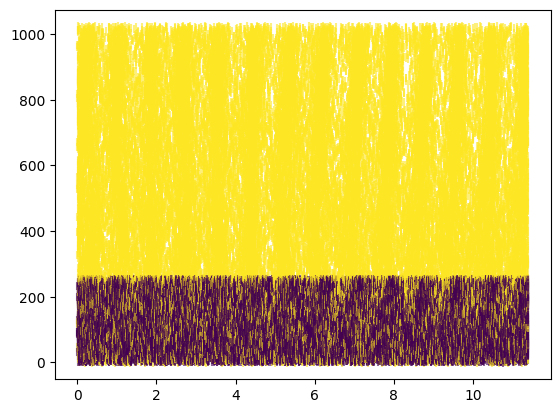

In [12]:
raw = np.loadtxt(r"C:\Users\Jacob\OneDrive - McMaster University\Documents\GitHub\M-Current-modulation-of-cortical-slow-oscillations\Raster_9.txt")

#converting all time measurements into number of time steps, don't need to so I won't
#raw[:,0] = np.around(raw[:,0]/0.00006,0)

plt.scatter(x=raw[:,0],y=raw[:,1],c=raw[:,2],marker="|",alpha = 0.6)

Here you can see the seperation of the inhibitory and excitatory neurons...

[1088.  285.  232. ...  976.  667. 1036.]


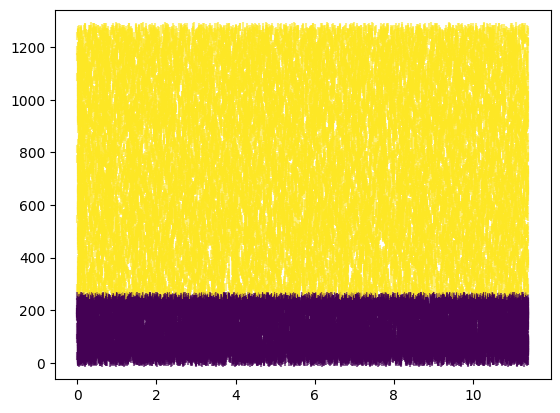

In [4]:
raw2 = np.where(raw[:,2]==0,raw[:,1],raw[:,1]+256)
print(raw2)

plt.scatter(x=raw[:,0],y=raw2,c=raw[:,2],marker="|",alpha = 0.6)


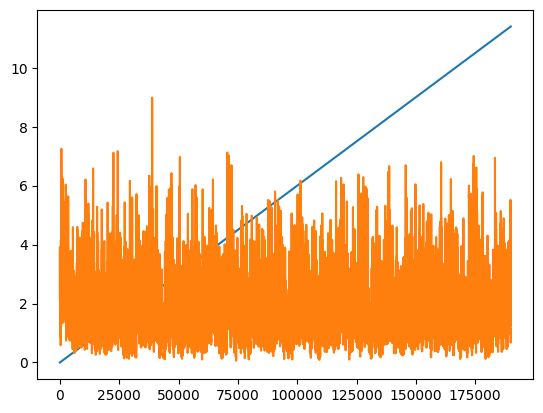

In [5]:
raw = np.loadtxt(r"C:\Users\Jacob\OneDrive - McMaster University\Documents\GitHub\M-Current-modulation-of-cortical-slow-oscillations\LFP_0.txt")

plt.plot(raw)

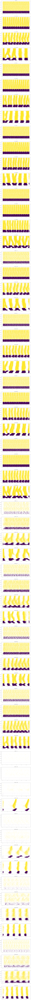

In [2]:
fig, axs = plt.subplots(64)
fig.set_figheight(500)
fig.set_figwidth(15)

#plt.scatter(x=raw[:,0],y=raw[:,1],c=raw[:,2],marker="|",alpha = 0.6)

for i in range(0,64):
    raw = np.loadtxt(r"C:\Users\Jacob\OneDrive - McMaster University\Documents\GitHub\M-Current-modulation-of-cortical-slow-oscillations\Raster_"+str(i)+".txt")
    raw2 = np.where(raw[:,2]==0,raw[:,1],raw[:,1]+256)
    axs[i].scatter(x=raw[:,0],y=raw2,c=raw[:,2],marker="|",alpha = 0.6)
    axs[i].set_title(str(cs[i,0:3]))


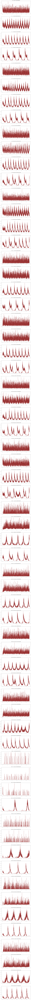

In [34]:
fig, axs = plt.subplots(64)
fig.set_figheight(500)
fig.set_figwidth(15)

#plt.scatter(x=raw[:,0],y=raw[:,1],c=raw[:,2],marker="|",alpha = 0.6)

domfs = np.zeros(64)

for i in range(64):
    raw = np.loadtxt(r"..\LFP_"+str(i)+".txt")

    #take the fourier transform
    freqs = fft.rfftfreq(len(raw[:,1]),0.00006)
    sp = fft.rfft(raw[:,1])
    #grab the dominant frequency (only concerned with a certain range, ie. ~0-4 Hz)
    f = freqs[np.argmax(sp.real[1:100])]
    domfs[i] = f

    axs[i].plot(raw[:,0],raw[:,1],color="maroon",alpha=0.8)
    axs[i].set_title(str(str(cs[i,0:3])+ " domf="+str(f)))


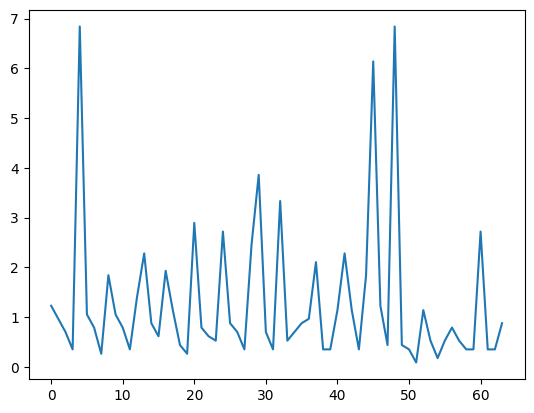

In [33]:
plt.plot(domfs)

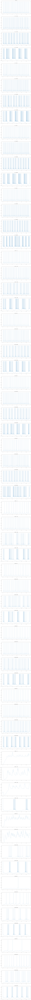

In [4]:
fig, axs = plt.subplots(64)
fig.set_figheight(500)
fig.set_figwidth(15)

#plt.scatter(x=raw[:,0],y=raw[:,1],c=raw[:,2],marker="|",alpha = 0.6)

ffts = []

for i in range(64):
    raw = np.loadtxt(r"C:\Users\Jacob\OneDrive - McMaster University\Documents\GitHub\M-Current-modulation-of-cortical-slow-oscillations\NEURONS_"+str(i)+".txt")
    axs[i].plot(raw[:,0],raw[:,1],alpha=0.4)
    axs[i].set_title(str(cs[i,0:3]))

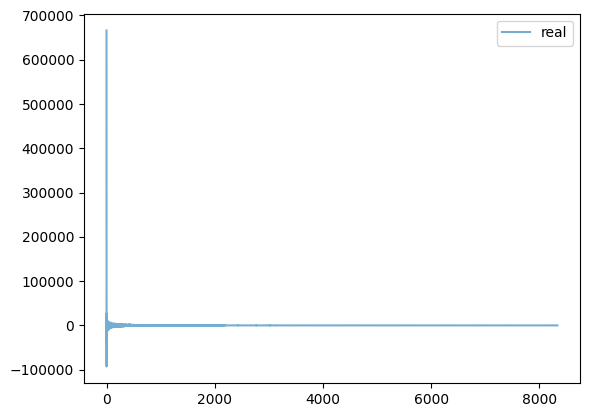

In [20]:
raw = np.loadtxt(r"..\LFP_"+str(1)+".txt")
raw = raw[:,1]

#calculate the frequencies associated with our signal
freqs = fft.rfftfreq(len(raw),0.00006)
sp = fft.rfft(raw)

#plt.plot(freqs, sp.real, freqs, sp.imag)


plt.plot(freqs, sp.real, label="real",alpha=0.6)
plt.legend()

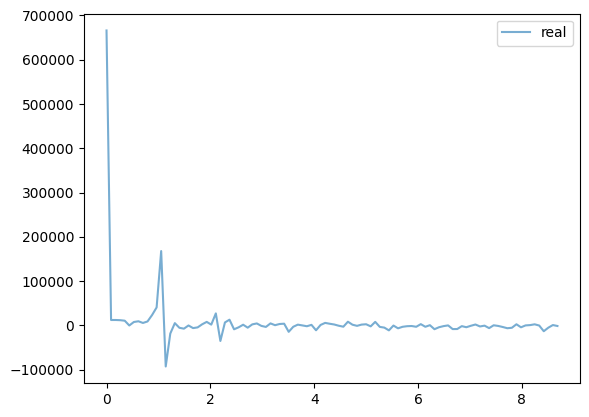

In [6]:
plt.plot(freqs[:100], sp.real[:100], label="real",alpha=0.6)
plt.legend()

0.9649173592141711


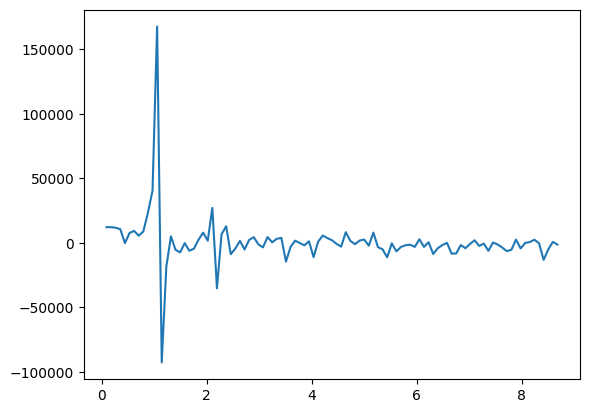

In [19]:

plt.plot(freqs[1:100],sp.real[1:100])

print(freqs[np.argmax(sp.real[1:100])])

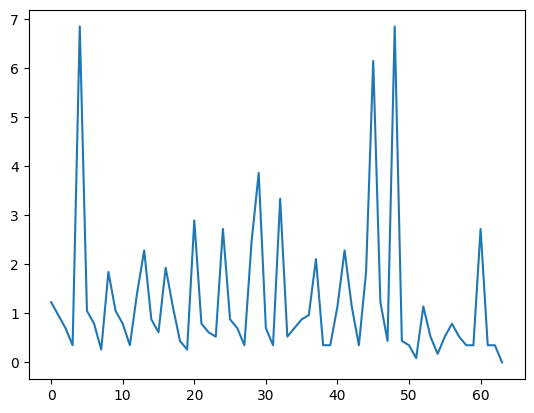

In [22]:
#array to hold frequencies
domfs = np.zeros(64)

for i in range(63):
    #load in the dataset
    raw = np.loadtxt(r"..\LFP_"+str(i)+".txt")
    raw = raw[:,1]
    #take the fourier transform
    freqs = fft.rfftfreq(len(raw),0.00006)
    sp = fft.rfft(raw)
    #grab the dominant frequency (only concerned with a certain range, ie. ~0-4 Hz)
    f = freqs[np.argmax(sp.real[1:100])]
    domfs[i] = f

plt.plot(domfs)
    